In [58]:
from matplotlib import pyplot as plt
import torchaudio
import torch
from PIL import Image
import math
import random
from IPython.display import Audio
from io import BytesIO

In [5]:
file = "/data/akashvani/nur_wav/0dZKWkF0rRs.wav"

In [17]:
wav, sr = torchaudio.load(file)
duration = wav.shape[-1]/sr
wav.shape, sr, duration

(torch.Size([1, 14482565]), 16000, 905.1603125)

In [60]:
%%time
def plot_segments(file, segment_labels):
    buffer=BytesIO()
    
    wav, sr = torchaudio.load(file)
    duration = wav.shape[-1]/sr

    fig = plt.figure(figsize=(100,4))
    time_axis = torch.linspace(0, duration, steps=wav.size(1))

    plt.plot(time_axis.numpy(), wav.flatten().numpy())
    plt.xticks(range(0, int(duration) + 1, 10))
    segments = [(i*10, (i+1)*10) for i in range(math.ceil(duration/10))]
    color="crimson"
    for (start, end), label in zip(segments, segment_labels):
        if label==int(1):
            color = random.choice(['red','green','blue','orange','yellow','gray'])
        plt.axvspan(start, end, color=color, alpha=0.3)
        # plt.axvline(x=end, color='b', linestyle='--', alpha=0.2)

    plt.savefig(buffer, format='png')
    buffer.seek(0)
    plt.close()
    img = Image.open(buffer)
    return img

CPU times: user 17 µs, sys: 2 µs, total: 19 µs
Wall time: 28.1 µs


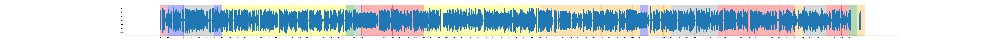

In [61]:
segment_labels = [0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0,
        1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0,
        1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1]

plot_segments(file, segment_labels)

In [59]:
Audio(file)